In [1]:
TRADE_API_KEY = "PKROZV1JRWV9SJ62U2LH"
TRADE_API_SECRET = "rAx7I05uxutbeMLngMeZrDDGWtt6TrtB2E0Y60yy"

In [2]:
PAPER=True 
TRADE_API_URL=None
TRADE_API_WSS=None
DATA_API_URL=None
OPTION_STREAM_DATA_WSS=None

In [3]:
api_key = TRADE_API_KEY
secret_key = TRADE_API_SECRET
paper = PAPER
trade_api_url = TRADE_API_URL

In [1]:
import json
from datetime import datetime, timedelta
from zoneinfo import ZoneInfo

import alpaca
from alpaca.data.live.stock import *
from alpaca.data.historical.stock import *
from alpaca.data.historical.crypto import *
from alpaca.data.requests import *
from alpaca.data.timeframe import *
from alpaca.common.exceptions import APIError

import yfinance as yf
import pandas as pd
import numpy as np
from scipy.signal import *

import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
from pandas.plotting import scatter_matrix
%matplotlib inline

import ta
from tqdm import tqdm
from sklearn.preprocessing import StandardScaler, MinMaxScaler
from sklearn.preprocessing import OneHotEncoder
from sklearn.linear_model import LogisticRegression
from sklearn.metrics import accuracy_score, roc_curve, confusion_matrix
from sklearn.model_selection import GridSearchCV
from sklearn.decomposition import PCA
import re
from collections import Counter
from sklearn.model_selection import train_test_split
import ta
import seaborn as sns
from scipy.signal import argrelextrema

from sklearn.metrics import roc_curve, auc
import seaborn as sns
from sklearn.metrics import confusion_matrix

import tensorflow as tf
from tensorflow import keras
from tensorflow.keras import layers
from sklearn.utils.class_weight import compute_class_weight


pd.set_option('display.max_rows', 200)


# Data Retrieval from Alpaca

In [2]:
stock_historical_data_client = StockHistoricalDataClient(api_key, secret_key, url_override=DATA_API_URL)
crypto_client = CryptoHistoricalDataClient(api_key, secret_key, url_override=DATA_API_URL)

NameError: name 'api_key' is not defined

In [ ]:
# Set which data you want to work with and other data parameters

data_type = 'crypto' # 'stock' or 'crypto'

stock_ticker = 'AAPL'
crypto_ticker = 'ETH/USD'

time_granularity = TimeFrameUnit.Minute

time_frame = 365      # number of days into the past you want to get data from
start_date = datetime.now() - timedelta(days=time_frame)
end_date = datetime.now() - timedelta(days=30)

std_setting = 2
mean_period = 60 # technical indicators will be based off past x minutes

In [ ]:
#retrieve data

stock_req = StockBarsRequest(
    symbol_or_symbols=stock_ticker,
    timeframe=TimeFrame(amount=1, unit=time_granularity), # specify timeframe
    start=start_date,                          # specify start datetime, default=the beginning of the current day.
    end=end_date,                                        # specify end datetime, default=now
    limit=400000,                                               # specify limit
)

crypto_req = CryptoBarsRequest(
    symbol_or_symbols=crypto_ticker,
    timeframe=TimeFrame(amount=1, unit=time_granularity), # specify timeframe
    start=start_date,                          # specify start datetime, default=the beginning of the current day.
    end=end_date,                                        # specify end datetime, default=now
    limit=400000,                                               # specify limit
)

if data_type == 'stock':
    data = stock_historical_data_client.get_stock_bars(stock_req).df
    security = stock_ticker
else:
    data = crypto_client.get_crypto_bars(crypto_req).df
    security = crypto_ticker

#changes index from tuple to only timestamp (for plotly to plot correctly)

data = data.reset_index(drop=False)
#data.index = data.index.get_level_values('timestamp')
#

,symbol,timestamp,open,high,low,close,volume,trade_count,vwap
0,ETH/USD,2024-02-19 18:12:00+00:00,2944.1500,2944.3800,2943.1900,2943.5965,0.000000,0.0,0.000000
1,ETH/USD,2024-02-19 18:13:00+00:00,2942.4000,2942.4000,2941.5810,2941.7500,0.000000,0.0,0.000000
2,ETH/USD,2024-02-19 18:14:00+00:00,2940.6000,2940.6000,2938.7785,2939.7400,0.000000,0.0,0.000000
3,ETH/USD,2024-02-19 18:15:00+00:00,2941.3080,2945.8050,2939.9750,2944.3665,0.000000,0.0,0.000000
4,ETH/USD,2024-02-19 18:16:00+00:00,2945.6235,2945.6235,2943.7400,2945.5450,0.000000,0.0,0.000000
...,...,...,...,...,...,...,...,...,...
360741,ETH/USD,2025-01-19 18:06:00+00:00,3428.2500,3428.2500,3428.2500,3428.2500,0.000000,0.0,3428.250000
360742,ETH/USD,2025-01-19 18:07:00+00:00,3430.3730,3431.8800,3428.2000,3428.2000,0.000000,0.0,3430.040000
360743,ETH/USD,2025-01-19 18:08:00+00:00,3430.2260,3434.4500,3425.8650,3430.2000,0.296306,1.0,3434.450000
360744,ETH/USD,2025-01-19 18:10:00+00:00,3428.4000,3436.1000,3428.4000,3435.7255,0.404622,2.0,3433.788969


In [3]:
def calculate_rsi(prices, period=14):
    """
    Calculate the Relative Strength Index (RSI) for a given time series array of stock prices.

    Args:
    - prices (list): A list of stock prices in chronological order.
    - period (int): The time period over which to calculate the RSI. Default is 14.

    Returns:
    - rsi_values (list): An array of RSI values corresponding to the input prices.
    """
    if len(prices) < period:
        raise ValueError("Length of prices array should be greater than or equal to the period.")

    delta = [prices[i + 1] - prices[i] for i in range(len(prices) - 1)]
    gain = [d if d > 0 else 0 for d in delta]
    loss = [abs(d) if d < 0 else 0 for d in delta]

    avg_gain = sum(gain[:period]) / period
    avg_loss = sum(loss[:period]) / period

    rsi_values = [None] * period

    rs = avg_gain / avg_loss if avg_loss != 0 else float('inf')
    rsi_values.append(100 - (100 / (1 + rs)))

    for i in range(period, len(prices) - 1):
        avg_gain = (avg_gain * (period - 1) + gain[i]) / period
        avg_loss = (avg_loss * (period - 1) + loss[i]) / period
        rs = avg_gain / avg_loss if avg_loss != 0 else float('inf')
        rsi_values.append(100 - (100 / (1 + rs)))

    return rsi_values

def calculate_adx(focus, window=14):
    """
    Calculate ADX (Average Directional Index) values for a given time series array of close prices.

    Args:
    close_prices (list or numpy array): Time series array of close prices.
    window (int): Window size for calculating ADX. Default is 14.

    Returns:
    adx_values (numpy array): Array of ADX values of the same length as input array.
    """
    # Initialize ADX indicator
    adx_indicator = ta.trend.ADXIndicator(high=focus['high'], low=focus['low'], close=focus['close'], window=window)

    # Calculate ADX values
    adx_values = adx_indicator.adx()

    return adx_values

def calculate_macd(close_prices):
    # Create a DataFrame with the close prices
    df = pd.DataFrame({'close': close_prices})
    
    # Calculate MACD using ta package
    df['macd'] = ta.trend.macd_diff(df['close'])
    
    # Extract MACD values
    macd_values = df['macd'].values
    
    return macd_values

In [9]:
data = pd.read_csv('hist_data/BTC_USD - 365 Day.csv')
#data = data[data['timestamp'] > '2024-11-30']

data['RSI'] = calculate_rsi(np.array(data['close']))
data['ADX'] = calculate_adx(data)
data['MACD'] = calculate_macd(np.array(data['close']))
data

,timestamp,symbol,open,high,low,close,volume,trade_count,vwap,RSI,ADX,MACD
0,2024-02-28 12:45:00+00:00,BTC/USD,59419.8350,59447.1180,59384.9000,59413.0400,0.003185,2.0,59385.242859,NaN,0.000000,NaN
1,2024-02-28 12:46:00+00:00,BTC/USD,59393.7965,59393.7965,59349.9650,59349.9650,0.000000,0.0,0.000000,NaN,0.000000,NaN
2,2024-02-28 12:47:00+00:00,BTC/USD,59338.2255,59380.6775,59322.5650,59380.6775,0.000000,0.0,0.000000,NaN,0.000000,NaN
3,2024-02-28 12:48:00+00:00,BTC/USD,59390.8350,59447.2100,59390.8350,59410.1815,0.000000,0.0,0.000000,NaN,0.000000,NaN
4,2024-02-28 12:49:00+00:00,BTC/USD,59429.2950,59433.3535,59415.3815,59433.3535,0.000000,0.0,0.000000,NaN,0.000000,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...
375207,2025-02-27 20:40:00+00:00,BTC/USD,83094.9645,83145.8575,82975.9350,82975.9350,0.000000,0.0,83060.896250,49.493743,24.777236,50.443183
375208,2025-02-27 20:41:00+00:00,BTC/USD,82998.1785,83127.9750,82998.1785,83020.9675,0.007888,1.0,83127.975000,51.790897,23.319922,51.127304
375209,2025-02-27 20:42:00+00:00,BTC/USD,83062.2240,83154.7765,83029.7500,83154.7765,0.000000,0.0,83092.263250,57.915909,22.176647,58.352039
375210,2025-02-27 20:43:00+00:00,BTC/USD,83195.1500,83321.8850,83170.2195,83273.2700,0.001565,1.0,83321.885000,62.463912,22.247649,68.187175


In [10]:
#Plotly plotting

fig = go.Figure()

fig.add_trace(go.Scatter(x=data['timestamp'],  y=data["close"], mode="lines", name="Close Price",line=dict(color="blue")))
fig.update_layout(title=f"Price Movement Over Time",xaxis_title="Time",yaxis_title="Price")

fig.show()

# Model Overview
### After data retrieval, data frame used will be 'focus'

Goal is to create a decently performing HFT model that is trading relatively stable, high-cap cryptocurrencies.

Step 0: Identify points at which to buy and sell. Conditions for labeling these points in training data will be below.

Step 1: Add in technical indicators.

Step 2: Train RL model on labeled data. The goal is for the model to be able to recognize when profitable rises in price are incoming.

Step 3: Backtest on other historical data / other coins.

Step 4: Implement model to run in the cloud, actively trading on paper account.

Step 5: Move to cash account when consistency / desired results are achieved

# Step 0: Label Buy / Sell

In [33]:
min_smoothness = 100 # Finds local minima where the price is lower than the surrounding x values
sell_threshold = 0.4
growth_threshold = 1.005

In [34]:
# Identify local minima
minima_indices = argrelextrema(data['close'].values, np.less, order=min_smoothness)[0]
# Create a boolean column with False by default
data['minima'] = False
# Set True only for local minima
data.iloc[minima_indices, data.columns.get_loc('minima')] = True

#maxima_indices = argrelextrema(data['close'].values, np.greater, order=min_smoothness)[0]
#data['maxima'] = False
#data.loc[maxima_indices, 'maxima'] = True


In [35]:
# identify minima that result in growth

data['buy'] = int(0)

for i in tqdm(range(len(data)), desc="Processing Minima"):
    if data.iloc[i]['minima']:
        j = i + 1
        start_price = data.iloc[i]['close']
        max_price = data.iloc[i]['close']

        while j < len(data):
            if data.iloc[j]['minima']:
                break
            
            elif data.iloc[j]['close'] > max_price:
                max_price = data.iloc[j]['close']

            elif data.iloc[j]['close'] < start_price + (max_price - start_price) * sell_threshold:
                break

            if data.iloc[j]['close'] > start_price * growth_threshold:
                data.at[i, 'buy'] = int(1)
                break

            j+=1

Processing Minima: 100%|██████████| 375212/375212 [00:11<00:00, 31365.96it/s]


In [36]:
#identify sell points by determining max points before dip is reached or next buy is reached

data['sell'] = int(0)


for i in tqdm(range(len(data)), desc="Processing sells"):
    if data.iloc[i]['buy']:
        j = i + 1
        start_price = data.iloc[i]['close']
        max_price = data.iloc[i]['close']
        max_index = 0

        while j < len(data):
            # if data.iloc[j]['buy']:
            #     data.loc[max_index, 'sell'] = 1
            #     break
            
            if data.iloc[j]['close'] > max_price:
                max_price = data.iloc[j]['close']
                max_index = j

            elif data.iloc[j]['close'] < start_price + (max_price - start_price) * sell_threshold:
                data.loc[j, 'sell'] = 1
                break


            j+=1

Processing sells: 100%|██████████| 375212/375212 [01:23<00:00, 4482.18it/s] 


In [37]:
#Plotly plotting

# Create figure
fig = go.Figure()

# Add trace for closing price
fig.add_trace(go.Scatter(x=data['timestamp'], y=data["close"], mode="lines", name="Close Price",line=dict(color="blue")))

fig.add_trace(go.Scatter(x = data.loc[data['minima'] == 1, 'timestamp'], y=data.loc[data['minima'] == 1, 'close'], mode='markers', name='Minima', marker=dict(color='green', size = 9)))
fig.add_trace(go.Scatter(x = data.loc[data['buy'] == 1, 'timestamp'], y=data.loc[data['buy'] == 1, 'close'], mode='markers', name='Buy', marker=dict(color='pink', size = 9)))

fig.add_trace(go.Scatter(x = data.loc[data['sell'] == 1, 'timestamp'], y=data.loc[data['sell'] == 1, 'close'], mode='markers', name='Sell', marker=dict(color='red', size = 9)))

# Customize layout
fig.update_layout(title=f"Price Movement Over Time",xaxis_title="Time",yaxis_title="Price")

# Show figure
fig.show()

In [ ]:
pos = False
buy_price = 0
growth_vals = [] 
growth = 1

for i in tqdm(range(len(data)), desc="Calculating Deltas"):
    if data.iloc[i]['buy']:
        pos = True
        buy_price = data.iloc[i]['close']
    
    if pos & data.iloc[i]['sell']:
        cur_growth = (data.iloc[i]['close']/buy_price)
        growth = growth * cur_growth
        growth_vals += [cur_growth]
        pos = False

Calculating Deltas: 100%|██████████| 375212/375212 [00:19<00:00, 19017.13it/s]


In [47]:
growth_prog = np.cumprod(growth_vals)

print('Total growth is ', round((growth - 1) * 100,2),f'% over a 365 day period.')
print(f'{len(growth_vals)} trades were executed.')

print_on = True
if print_on:
    width = 10
    counter = 0
    for i in growth_vals:
        if counter%10 ==0:
            print()
        if i<1:
            print("\033[91m" + f"{round(i,5):>{width}.{5}f}" + " ", end="")
        else:
            print("\033[92m" + f"{round(i,5):>{width}.{5}f}" + " ", end="")
        counter += 1

fig4 = go.Figure()
fig4.add_trace(go.Scatter(x=np.arange(len(growth_prog)), y= growth_prog, mode='lines', name='Growth Progression', line=dict(color='blue')))
fig4.update_layout(width=800, height=400, title='Growth Progression')
fig4.show()

Total growth is  1588.82 % over a 365 day period.
568 trades were executed.

   1.01541    1.00299    1.00542    1.00751    1.00462    1.00703    1.00211    1.00214    1.00000    1.01100 
   1.00000    1.01367    1.01051    1.00820    1.00510    1.00256    1.00296    1.00258    1.00551    1.00557 
   1.00556    1.00354    1.00265    1.00328    1.00251    1.00539    1.00743    1.02069    1.00670    1.00257 
   1.00396    1.00354    1.00295    1.00560    1.00458    1.00376    1.00236    1.00492    1.00533    1.00600 
   1.00397    1.00423    1.00105    1.00775    1.00837    1.00616    1.00902    1.00712    1.00183    1.00222 
   1.00431    1.00740    1.00510    1.00514    1.00243    1.00390    1.00591    1.00784    1.00124    1.00264 
   1.00233    1.00931    1.00411    1.00923    1.00489    1.00351    1.00338    1.00426    1.00218    1.00215 
   1.00166    1.00296    1.00283    1.00325    1.00456    1.00193    1.00589    1.00497    1.00707    1.00281 
   1.00302    1.00630    1.00644   

# Step 1: Technical Indicators

In [49]:
mean_period = 30

In [63]:
focus = data.copy()

focus['mean'] = focus['close'].ewm(span=mean_period, adjust=False).mean() #SMA of past 60m
focus['std'] = [np.std(focus['close'][i-mean_period+1:i+1]) for i in range(len(focus))] #current STD of past 60m
focus['std_from_mean'] = [(focus['close'].iloc[i] - focus['mean'].iloc[i])/ focus['std'].iloc[i] for i in range(len(focus))] # STD distance of price from mean

focus['5m_slope'] = [(focus['close'].iloc[i] - focus['close'].iloc[i-5])/5 for i in range(len(focus))]
focus['10m_slope'] = [(focus['close'].iloc[i] - focus['close'].iloc[i-10])/10 for i in range(len(focus))]
focus['30m_slope'] = [(focus['close'].iloc[i] - focus['close'].iloc[i-30])/30 for i in range(len(focus))]
focus['2h_slope'] = [(focus['close'].iloc[i] - focus['close'].iloc[i-120])/120 for i in range(len(focus))]

# focus['n-BU'] = [focus['n_mean'].iloc[i] + std_setting * focus['n_std'].iloc[i] for i in range(len(focus))]
# focus['n-BL'] = [focus['n_mean'].iloc[i] - std_setting * focus['n_std'].iloc[i] for i in range(len(focus))]

# drop rows in first period
focus = focus.iloc[mean_period:]

focus

,timestamp,symbol,open,high,low,close,volume,trade_count,vwap,RSI,...,minima,buy,sell,mean,std,std_from_mean,5m_slope,10m_slope,30m_slope,2h_slope
30,2024-02-28 13:15:00+00:00,BTC/USD,59862.7095,59862.7095,59679.3965,59679.3965,0.000000,0.0,0.00000,52.912823,...,False,0,0,59614.688386,215.090062,0.300842,-33.6137,21.979650,8.878550,-203.793721
31,2024-02-28 13:16:00+00:00,BTC/USD,59663.6875,59784.7850,59663.6875,59784.7850,0.000000,0.0,0.00000,58.496542,...,False,0,0,59625.662361,215.983178,0.736736,-25.8416,-8.757250,14.494000,-203.482333
32,2024-02-28 13:17:00+00:00,BTC/USD,59748.6500,59884.7575,59748.6500,59868.2000,0.004389,1.0,59860.90000,62.306523,...,False,0,0,59641.309950,220.080502,1.030941,-1.8200,9.013500,16.250750,-201.884333
33,2024-02-28 13:18:00+00:00,BTC/USD,59881.9500,59938.8000,59848.7000,59917.1765,0.001623,1.0,59938.80000,64.374419,...,False,0,0,59659.107792,225.963611,1.142081,10.9757,-1.077350,16.899833,-201.236962
34,2024-02-28 13:19:00+00:00,BTC/USD,59879.8180,59904.2110,59867.2450,59880.7675,0.000000,0.0,0.00000,61.666011,...,False,0,0,59673.408419,229.572258,0.903241,10.7505,2.864550,14.913800,-202.502363
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
375207,2025-02-27 20:40:00+00:00,BTC/USD,83094.9645,83145.8575,82975.9350,82975.9350,0.000000,0.0,83060.89625,49.493743,...,False,0,0,83009.873056,123.188305,-0.275497,31.7221,17.707466,-9.380183,-13.369583
375208,2025-02-27 20:41:00+00:00,BTC/USD,82998.1785,83127.9750,82998.1785,83020.9675,0.007888,1.0,83127.97500,51.790897,...,False,0,0,83010.588827,115.912574,0.089539,34.4243,23.905650,-4.950750,-13.173271
375209,2025-02-27 20:42:00+00:00,BTC/USD,83062.2240,83154.7765,83029.7500,83154.7765,0.000000,0.0,83092.26325,57.915909,...,False,0,0,83019.891258,120.707680,1.117454,40.5683,49.456000,2.956383,-11.762708
375210,2025-02-27 20:43:00+00:00,BTC/USD,83195.1500,83321.8850,83170.2195,83273.2700,0.001565,1.0,83321.88500,62.463912,...,False,0,0,83036.238273,134.629735,1.760619,60.4170,54.047000,7.499000,-10.696867


In [67]:
buys = focus[focus['buy']==1]
buys

,timestamp,symbol,open,high,low,close,volume,trade_count,vwap,RSI,...,minima,buy,sell,mean,std,std_from_mean,5m_slope,10m_slope,30m_slope,2h_slope
298,2024-02-28 17:43:00+00:00,BTC/USD,60566.91900,61220.2670,57296.34792,57296.34792,0.059571,1.0,60566.919000,26.466660,...,True,1,0,61229.832329,1586.547118,-2.479274,-588.633416,-320.865058,-204.248069,-29.914851
504,2024-02-28 21:09:00+00:00,BTC/USD,59946.53600,59970.2780,59804.93500,59843.24850,0.000129,1.0,59946.536000,31.863791,...,True,1,0,60193.996475,161.201774,-2.175832,-59.909800,-55.076100,-16.524533,-12.055421
759,2024-02-29 01:26:00+00:00,BTC/USD,61138.88950,61139.0150,61046.94500,61103.35000,0.000000,0.0,0.000000,34.635958,...,True,1,0,61337.413071,93.739673,-2.496948,-42.063500,-24.903450,-11.844500,-10.430708
1283,2024-02-29 10:16:00+00:00,BTC/USD,62306.50500,62314.7000,62118.80900,62235.36750,0.011982,2.0,62307.109925,26.769888,...,True,1,0,62509.975246,147.707851,-1.859128,-26.350000,-28.443050,-11.213367,-6.678117
1470,2024-02-29 13:29:00+00:00,BTC/USD,62311.65500,62311.6550,62092.55950,62260.14750,0.000000,0.0,0.000000,31.354082,...,True,1,0,62549.884625,170.052632,-1.703809,-36.864700,-49.002750,-13.219800,-5.975396
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
373551,2025-02-26 14:25:00+00:00,BTC/USD,85552.15219,85638.1400,85375.29500,85375.29500,0.019203,4.0,85508.640423,18.870501,...,True,1,0,86352.624623,448.634761,-2.178453,-149.150000,-108.362950,-67.349172,-26.128958
373901,2025-02-26 20:19:00+00:00,BTC/USD,82733.04000,82733.0400,82252.09500,82253.82350,0.000512,2.0,82377.909713,18.203976,...,True,1,0,83494.482559,498.782620,-2.487374,-165.609300,-150.529150,-59.745717,-29.426054
374283,2025-02-27 02:59:00+00:00,BTC/USD,84218.84350,84270.5000,84181.10000,84181.10000,0.000000,0.0,84225.800000,32.587253,...,True,1,0,84512.356264,206.662971,-1.602882,-54.183000,-30.695000,-26.376800,-3.846458
374602,2025-02-27 09:22:00+00:00,BTC/USD,85820.97050,85820.9705,85820.97050,85820.97050,0.000000,0.0,85820.970500,40.050393,...,True,1,0,85988.477629,113.975932,-1.469671,-9.069400,-9.054200,-1.431617,-4.493162


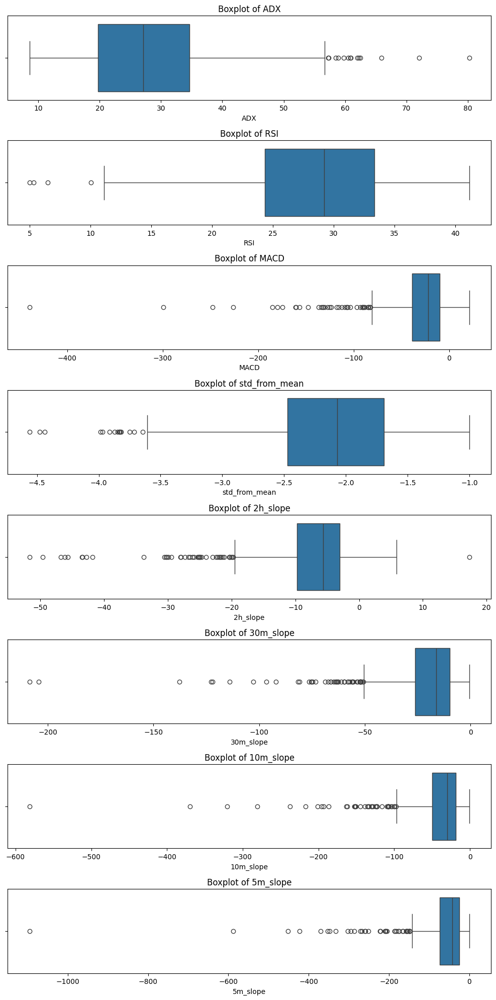

In [ ]:
# List of columns to plot
columns = ['2h_slope', '30m_slope', '10m_slope', '5m_slope']

# Create a figure with subplots
fig, axes = plt.subplots(nrows=len(columns), ncols=1, figsize=(10, 20))

# Plot each column's boxplot
for i, col in enumerate(columns):
    sns.boxplot(x=buys[col], ax=axes[i])
    axes[i].set_title(f'Boxplot of {col}')
    axes[i].set_xlabel(col)

plt.tight_layout()
plt.show()

Normalize data

In [17]:
# Standardization (Z-score) for price-based and statistical features
price_stats_scaler = StandardScaler()
focus[['open', 'high', 'low', 'close', 'vwap', 'mean', 'std']] = price_stats_scaler.fit_transform(
    focus[['open', 'high', 'low', 'close', 'vwap', 'mean', 'std']]
)

# Log transformation for volume and trade_count (to handle skewness)
focus[['volume', 'trade_count']] = np.log1p(focus[['volume', 'trade_count']])

# Standardization for volume and trade_count after log transformation
trade_scaler = StandardScaler()
focus[['volume', 'trade_count']] = trade_scaler.fit_transform(focus[['volume', 'trade_count']])

# Min-Max Scaling for RSI and ADX (range 0-1)
rsi_adx_scaler = MinMaxScaler()
focus[['RSI', 'ADX']] = rsi_adx_scaler.fit_transform(focus[['RSI', 'ADX']])

# Standardization for MACD
macd_scaler = StandardScaler()
focus[['MACD']] = macd_scaler.fit_transform(focus[['MACD']])

In [18]:
focus.tail(5)

,symbol,timestamp,open,high,low,close,volume,trade_count,vwap,minima,buy,sell,mean,std,std_from_mean,RSI,ADX,MACD,30m slope,2h slope
360741,ETH/USD,2025-01-19 18:06:00+00:00,0.574329,0.571819,0.576787,0.574308,-0.109055,-0.255620,2.315251,False,0,0,0.559975,1.099188,0.442278,0.477174,0.307555,-1.624835,-21.7900,-36.255
360742,ETH/USD,2025-01-19 18:07:00+00:00,0.578923,0.579673,0.576679,0.574199,-0.109055,-0.255620,2.316689,False,0,0,0.560451,1.099967,0.424476,0.476585,0.292659,-1.931115,-25.2540,-28.880
360743,ETH/USD,2025-01-19 18:08:00+00:00,0.578605,0.585234,0.571624,0.578528,1.972326,2.852861,2.320230,False,0,0,0.561054,1.102800,0.536397,0.503201,0.283672,-1.953480,-20.6740,-35.940
360744,ETH/USD,2025-01-19 18:10:00+00:00,0.574653,0.588804,0.577112,0.590486,2.615943,4.671206,2.319699,False,0,0,0.562029,1.121525,0.861102,0.569590,0.278329,-1.589635,-24.1285,-37.177
360745,ETH/USD,2025-01-19 18:11:00+00:00,0.586718,0.584206,0.589181,0.586697,-0.109055,-0.255620,2.319849,False,0,0,0.562848,1.138262,0.718202,0.545197,0.273368,-1.417369,-22.0350,-34.294


# Step 2: Train Model

2 models need to be trained: a buy-model and a sell-model. Features to be used for training:

['volume','vwap','trade_count','std','std_from_mean','RSI','ADX','MACD']

In [19]:
columns_to_drop = ['symbol','timestamp','high','low','open','minima','buy','sell']

In [20]:
print('Default Model')
train, val = train_test_split(focus, test_size = 0.2, random_state = 40)

y_train = np.array(train['minima'])
x_train = train.drop(columns = columns_to_drop).to_numpy()
y_val = np.array(val['minima'])
x_val = val.drop(columns = columns_to_drop).to_numpy()

lr_buy_model = LogisticRegression(
        fit_intercept=True,
        penalty='l2',
        max_iter=10000)

lr_buy_model.fit(x_train, y_train)

train_probs = lr_buy_model.predict_proba(x_train)[:, 1]  # Probabilities of positive class (class 1)
val_probs = lr_buy_model.predict_proba(x_val)[:, 1]

# Define your threshold (e.g., 0.5 for the default threshold)
threshold = 0.5

# Apply threshold for classification
train_pred = (train_probs > threshold).astype(int)
val_pred = (val_probs > threshold).astype(int)

training_accuracy = sum(train_pred==y_train)/len(y_train)
val_accuracy = sum(val_pred==y_val)/len(y_val)
one_predictor_accuracy = sum(1==y_train)/len(y_train)

print("One Predictor Accuracy: ", one_predictor_accuracy)
print("Training Accuracy: ", training_accuracy)
print("Validation Accuracy: ", val_accuracy)

Default Model
One Predictor Accuracy:  0.002276917531918433
Training Accuracy:  0.9976953574448618
Validation Accuracy:  0.9978652028057334


In [ ]:
# Split Data
train, val = train_test_split(focus, test_size=0.2, random_state=40)

y_train = np.array(train['minima'])
x_train = train.drop(columns=columns_to_drop).to_numpy()
y_val = np.array(val['minima'])
x_val = val.drop(columns=columns_to_drop).to_numpy()

# Compute Class Weights to Handle Imbalance
class_weights = compute_class_weight(
    class_weight='balanced',
    classes=np.unique(y_train),
    y=y_train
)
class_weights = {i: class_weights[i] for i in range(len(class_weights))}

# Define Neural Network Model
model = keras.Sequential([
    layers.Input(shape=(x_train.shape[1],)),  # Input layer
    layers.Dense(64, activation='relu'),      # Hidden layer 1
    layers.BatchNormalization(),              # Normalize activations
    layers.Dropout(0.3),                      # Prevent overfitting
    layers.Dense(32, activation='relu'),      # Hidden layer 2
    layers.BatchNormalization(),
    layers.Dropout(0.3),
    layers.Dense(1, activation='sigmoid')     # Output layer (probability)
])

# Compile Model
model.compile(
    optimizer=keras.optimizers.Adam(learning_rate=0.001),  
    loss='binary_crossentropy',
    metrics=['accuracy']
)

# Train Model
history = model.fit(
    x_train, y_train,
    validation_data=(x_val, y_val),
    epochs=50,
    batch_size=64,
    class_weight=class_weights,
    verbose=1
)

Epoch 1/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - accuracy: 0.7560 - loss: 0.4560 - val_accuracy: 0.8711 - val_loss: 0.3041
Epoch 2/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8517 - loss: 0.2975 - val_accuracy: 0.8749 - val_loss: 0.2860
Epoch 3/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8640 - loss: 0.2688 - val_accuracy: 0.8537 - val_loss: 0.3185
Epoch 4/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - accuracy: 0.8645 - loss: 0.2533 - val_accuracy: 0.8647 - val_loss: 0.2822
Epoch 5/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - accuracy: 0.8648 - loss: 0.2421 - val_accuracy: 0.8678 - val_loss: 0.2963
Epoch 6/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 6s 1ms/step - accuracy: 0.8718 - loss: 0.2315 - val_accuracy: 0.8366 - val_loss: 0.3539
Epoch 7/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8565 - loss: 0.2637 - val_accuracy: 0.8917 - val_loss: 0.2151
Epoch 8/50
4509/4509 ━━━━━━━━━━━━━━━━━━━━ 5s 1ms/step - accuracy: 0.8671 - loss: 0.2476 - 

In [33]:
# Get Probabilities
train_probs = model.predict(x_train).flatten()
val_probs = model.predict(x_val).flatten()

# Define Threshold (adjustable)
threshold = 0.96  # Lowering to increase positive detections
train_pred = (train_probs > threshold).astype(int)
val_pred = (val_probs > threshold).astype(int)

# Calculate Accuracy
training_accuracy = np.mean(train_pred == y_train)
val_accuracy = np.mean(val_pred == y_val)
one_predictor_accuracy = np.mean(y_train == 1)

print("One Predictor Accuracy:", one_predictor_accuracy)
print("Training Accuracy:", training_accuracy)
print("Validation Accuracy:", val_accuracy)

9018/9018 ━━━━━━━━━━━━━━━━━━━━ 4s 491us/step
2255/2255 ━━━━━━━━━━━━━━━━━━━━ 1s 431us/step
One Predictor Accuracy: 0.002276917531918433
Training Accuracy: 0.9954530961919681
Validation Accuracy: 0.9962710360697552


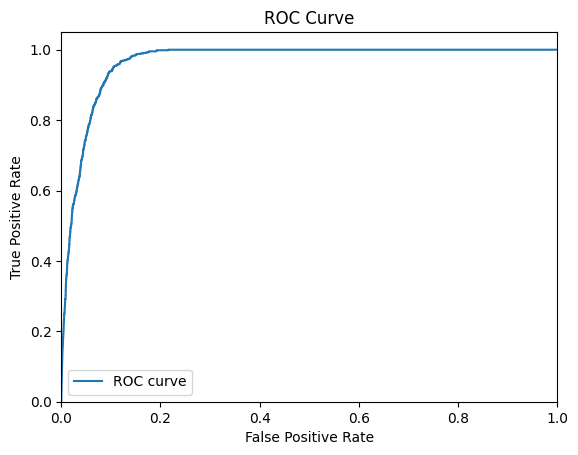

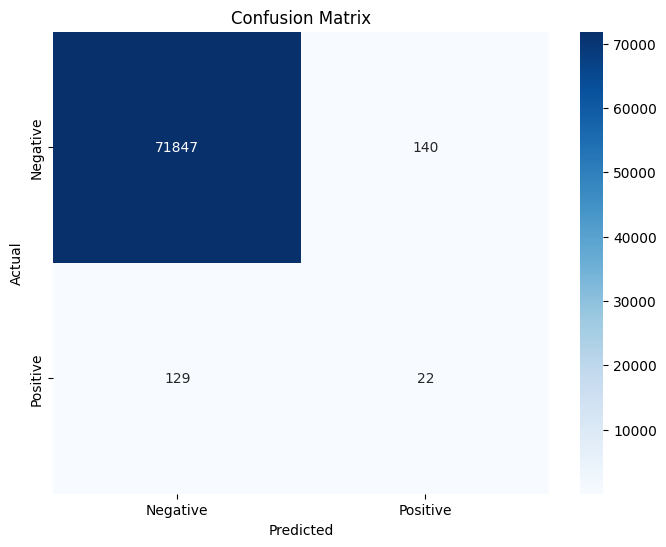

In [34]:
#ROC Curve
probs = lr_buy_model.predict_proba(x_train)
preds = probs[:,1]

false_pos_rate, true_pos_rate, threshold = roc_curve(y_train, preds)
ROC = auc(false_pos_rate, true_pos_rate)

plt.figure()
plt.plot(false_pos_rate, true_pos_rate, label='ROC curve')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])

plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curve')
plt.legend()

plt.show()

#CONFUSION MATRIX
# Example ground truth and predicted labels
true_labels = y_val
predicted_labels = val_pred

# Generate confusion matrix
cm = confusion_matrix(true_labels, predicted_labels)

# Plot confusion matrix
plt.figure(figsize=(8, 6))
sns.heatmap(cm, annot=True, fmt='d', cmap='Blues', xticklabels=['Negative', 'Positive'], yticklabels=['Negative', 'Positive'])
plt.xlabel('Predicted')
plt.ylabel('Actual')
plt.title('Confusion Matrix')
plt.show()
